In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import pandas_profiling
import seaborn as sns

In [2]:
df=pd.read_csv("C:/Users/gaura/OneDrive/Desktop/Data Science/Assignments/4. Segmentation of Credit Card Customers/CC_GENERAL.csv")

In [3]:
df.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


In [4]:
pandas_profiling.ProfileReport(df)

In [5]:
df['Monthly_avg_purchase']=df['PURCHASES']/df['TENURE']
df['Monthly_cash_advance']=df['CASH_ADVANCE']/df['TENURE']
df['limit_usage']=df['BALANCE']/df['CREDIT_LIMIT']

df.loc[(df['ONEOFF_PURCHASES']==0) & (df['INSTALLMENTS_PURCHASES']==0),'purchase_type']='None'
df.loc[(df['ONEOFF_PURCHASES']>0) & (df['INSTALLMENTS_PURCHASES']==0),'purchase_type']='One_Of'
df.loc[(df['ONEOFF_PURCHASES']==0) & (df['INSTALLMENTS_PURCHASES']>0),'purchase_type']='Installment_Purchases'
df.loc[(df['ONEOFF_PURCHASES']>0) & (df['INSTALLMENTS_PURCHASES']>0),'purchase_type']='Both'

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 22 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   CUST_ID                           8950 non-null   object 
 1   BALANCE                           8950 non-null   float64
 2   BALANCE_FREQUENCY                 8950 non-null   float64
 3   PURCHASES                         8950 non-null   float64
 4   ONEOFF_PURCHASES                  8950 non-null   float64
 5   INSTALLMENTS_PURCHASES            8950 non-null   float64
 6   CASH_ADVANCE                      8950 non-null   float64
 7   PURCHASES_FREQUENCY               8950 non-null   float64
 8   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 9   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 10  CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 11  CASH_ADVANCE_TRX                  8950 non-null   int64  
 12  PURCHA

In [39]:
# on the basis of Profile Report we should drop cust_id, Purchase and Oneoff_Purchase
df=df.drop(['CUST_ID'],axis=1)

#### Seperate out the Numerical and Categorical Data

In [40]:
df_num= [key for key in dict(df.dtypes)if dict(df.dtypes)[key] in ['int64','float64']]
df_cat= [key for key in dict(df.dtypes) if dict(df.dtypes)[key] in ['object']]

In [41]:
df_num=df[df_num]

In [42]:
df_num.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Monthly_avg_purchase,Monthly_cash_advance,limit_usage
0,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,7.950000,0.000000,0.040901
1,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,0.000000,536.912124,0.457495
2,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,64.430833,0.000000,0.332687
3,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12,124.916667,17.149001,0.222223
4,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,1.333333,0.000000,0.681429


In [43]:
df_cat

['purchase_type']

#### Handling Outlier

In [44]:
df_num=df_num.apply(lambda x : x.clip(lower=x.quantile(0.01),upper=x.quantile(0.99)))

In [45]:
df_num.isnull().sum()

BALANCE                               0
BALANCE_FREQUENCY                     0
PURCHASES                             0
ONEOFF_PURCHASES                      0
INSTALLMENTS_PURCHASES                0
CASH_ADVANCE                          0
PURCHASES_FREQUENCY                   0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_INSTALLMENTS_FREQUENCY      0
CASH_ADVANCE_FREQUENCY                0
CASH_ADVANCE_TRX                      0
PURCHASES_TRX                         0
CREDIT_LIMIT                          1
PAYMENTS                              0
MINIMUM_PAYMENTS                    313
PRC_FULL_PAYMENT                      0
TENURE                                0
Monthly_avg_purchase                  0
Monthly_cash_advance                  0
limit_usage                           1
dtype: int64

#### Handle missing values

In [46]:
def Missing_Imputation (x):
    x=x.fillna(x.mean())
    return x
df_num=df_num.apply(lambda x:Missing_Imputation (x))

In [47]:
df_num.isnull().sum()

BALANCE                             0
BALANCE_FREQUENCY                   0
PURCHASES                           0
ONEOFF_PURCHASES                    0
INSTALLMENTS_PURCHASES              0
CASH_ADVANCE                        0
PURCHASES_FREQUENCY                 0
ONEOFF_PURCHASES_FREQUENCY          0
PURCHASES_INSTALLMENTS_FREQUENCY    0
CASH_ADVANCE_FREQUENCY              0
CASH_ADVANCE_TRX                    0
PURCHASES_TRX                       0
CREDIT_LIMIT                        0
PAYMENTS                            0
MINIMUM_PAYMENTS                    0
PRC_FULL_PAYMENT                    0
TENURE                              0
Monthly_avg_purchase                0
Monthly_cash_advance                0
limit_usage                         0
dtype: int64

#### Correlations

In [48]:
df.corr()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Monthly_avg_purchase,Monthly_cash_advance,limit_usage
BALANCE,1.000000,0.322412,0.181261,0.164350,0.126469,0.496692,-0.077944,0.073166,-0.063186,0.449218,0.385152,0.154338,0.531283,0.322802,0.398684,-0.318959,0.072692,0.179711,0.475431,0.503518
BALANCE_FREQUENCY,0.322412,1.000000,0.133674,0.104323,0.124292,0.099388,0.229715,0.202415,0.176079,0.191873,0.141555,0.189626,0.095843,0.065008,0.132569,-0.095082,0.119776,0.131281,0.086020,0.404557
PURCHASES,0.181261,0.133674,1.000000,0.916845,0.679896,-0.051474,0.393017,0.498430,0.315567,-0.120143,-0.067175,0.689561,0.356963,0.603264,0.093860,0.180379,0.086288,0.995845,-0.055473,-0.057464
ONEOFF_PURCHASES,0.164350,0.104323,0.916845,1.000000,0.330622,-0.031326,0.264937,0.524891,0.127729,-0.082628,-0.046212,0.545523,0.319724,0.567292,0.048755,0.132763,0.064150,0.913060,-0.034545,-0.042254
INSTALLMENTS_PURCHASES,0.126469,0.124292,0.679896,0.330622,1.000000,-0.064244,0.442418,0.214042,0.511351,-0.132318,-0.073999,0.628108,0.256499,0.384084,0.132172,0.182569,0.086143,0.677024,-0.067782,-0.058318
CASH_ADVANCE,0.496692,0.099388,-0.051474,-0.031326,-0.064244,1.000000,-0.215507,-0.086754,-0.177070,0.628522,0.656498,-0.075850,0.303985,0.453238,0.140107,-0.152935,-0.068312,-0.047502,0.976364,0.215171
PURCHASES_FREQUENCY,-0.077944,0.229715,0.393017,0.264937,0.442418,-0.215507,1.000000,0.501343,0.862934,-0.308478,-0.203478,0.568430,0.119788,0.103464,0.003030,0.305802,0.061506,0.395337,-0.215786,-0.201944
ONEOFF_PURCHASES_FREQUENCY,0.073166,0.202415,0.498430,0.524891,0.214042,-0.086754,0.501343,1.000000,0.142329,-0.111716,-0.069088,0.544869,0.295038,0.243537,-0.030327,0.157531,0.082466,0.499711,-0.089034,-0.092089
PURCHASES_INSTALLMENTS_FREQUENCY,-0.063186,0.176079,0.315567,0.127729,0.511351,-0.177070,0.862934,0.142329,1.000000,-0.262958,-0.169207,0.529975,0.060755,0.085551,0.030073,0.250087,0.073275,0.314136,-0.179333,-0.161536
CASH_ADVANCE_FREQUENCY,0.449218,0.191873,-0.120143,-0.082628,-0.132318,0.628522,-0.308478,-0.111716,-0.262958,1.000000,0.799561,-0.131168,0.132616,0.183192,0.098838,-0.249773,-0.133372,-0.116109,0.628312,0.360168


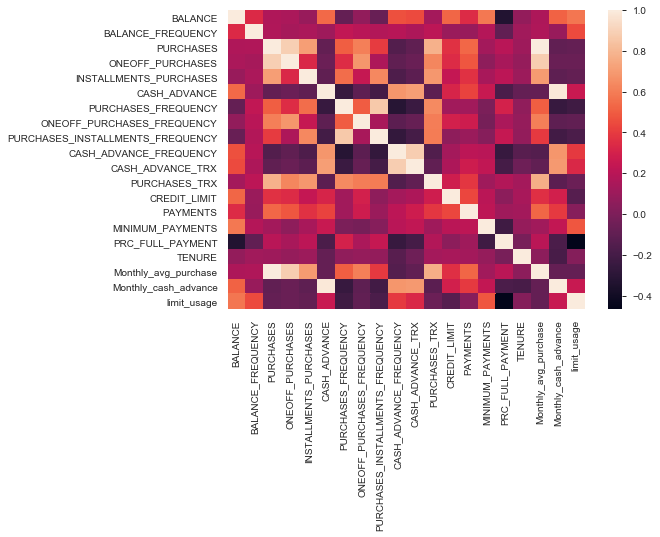

In [49]:
# visualize correlation matrix in Seaborn using a heatmap
sns.heatmap(df_num.corr())

#### Standardrizing data

In [50]:
from sklearn.preprocessing import StandardScaler

In [51]:
sc=StandardScaler()
df_scaled=sc.fit_transform(df_num)
df_scaled

array([[-0.76285553, -0.25596817, -0.55132729, ..., -0.56047278,
        -0.51832269, -0.98496088],
       [ 0.84486711,  0.13250091, -0.61388057, ..., -0.62184158,
         2.75876322,  0.20397188],
       [ 0.48518086,  0.52096999, -0.10691708, ..., -0.12447772,
        -0.51832269, -0.15222407],
       ...,
       [-0.7717557 , -0.19122546, -0.51919825, ..., -0.43606267,
        -0.51832269, -1.03491062],
       [-0.77681097, -0.19122546, -0.61388057, ..., -0.62184158,
        -0.48113278, -1.0248749 ],
       [-0.59412458, -0.90341664,  0.10295769, ...,  0.78468749,
        -0.38908955, -0.21528585]])

In [52]:
#turn the result back to a dataframe
cols = df.select_dtypes(include=['float64','int64']).columns
pd.DataFrame(df_scaled, columns=cols).head(10)

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Monthly_avg_purchase,Monthly_cash_advance,limit_usage
0,-0.762856,-0.255968,-0.551327,-0.489121,-0.427513,-0.527079,-0.806490,-0.678661,-0.707313,-0.685371,-0.557505,-0.579714,-0.978471,-0.642945,-4.999171e-01,-0.525551,0.36068,-0.560473,-0.518323,-0.984961
1,0.844867,0.132501,-0.613881,-0.489121,-0.568588,3.101370,-1.221758,-0.678661,-0.916995,0.593147,0.166685,-0.675130,0.711257,1.089747,2.429027e-01,0.234227,0.36068,-0.621842,2.758763,0.203972
2,0.485181,0.520970,-0.106917,0.215778,-0.568588,-0.527079,1.269843,2.673451,-0.916995,-0.685371,-0.557505,-0.102638,0.852068,-0.456289,-1.114982e-01,-0.525551,0.36068,-0.124478,-0.518323,-0.152224
3,0.063882,-1.032906,0.369006,0.877517,-0.568588,-0.411186,-1.014125,-0.399319,-0.916995,-0.259200,-0.376457,-0.627422,0.852068,-0.732573,-1.086356e-15,-0.525551,0.36068,0.342433,-0.413652,-0.467480
4,-0.367830,0.520970,-0.603389,-0.474534,-0.568588,-0.527079,-1.014125,-0.399319,-0.916995,-0.685371,-0.557505,-0.627422,-0.922146,-0.431298,-4.160807e-01,-0.525551,0.36068,-0.611549,-0.518323,0.843062
5,0.136681,0.520970,0.260344,-0.489121,1.403039,-0.527079,0.439310,-0.678661,0.550784,-0.685371,-0.557505,-0.293468,-0.753174,-0.110752,1.305898e+00,-0.525551,0.36068,0.235829,-0.518323,1.767827
6,-0.464679,0.520970,4.035657,5.348155,0.449374,-0.527079,1.269843,2.673451,1.599199,-0.685371,-0.557505,2.378162,2.541796,2.089631,-4.532885e-01,2.893453,0.36068,3.939655,-0.518323,-0.969084
7,0.143711,0.520970,-0.327867,-0.489121,0.076455,-0.527079,1.269843,-0.678661,1.599199,-0.685371,-0.557505,-0.102638,-0.612363,-0.430973,-1.873472e-01,-0.525551,0.36068,-0.341243,-0.518323,1.161173
8,-0.267543,0.520970,-0.049006,0.113959,-0.272832,-0.527079,-0.391225,-0.399319,-0.287947,-0.685371,-0.557505,-0.436591,0.711257,-0.426881,-3.625910e-01,-0.525551,0.36068,-0.067663,-0.518323,-0.687899
9,-0.706244,-1.421375,0.226458,0.679313,-0.568588,-0.527079,-0.806490,-0.119974,-0.916995,-0.685371,-0.557505,-0.532007,1.837743,-0.215252,-5.311384e-01,-0.525551,0.36068,0.202585,-0.518323,-1.062194


In [53]:
pd.DataFrame(df_scaled).describe()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
count,8.950000e+03,8.950000e+03,8.950000e+03,8.950000e+03,8.950000e+03,8.950000e+03,8.950000e+03,8.950000e+03,8.950000e+03,8.950000e+03,8.950000e+03,8.950000e+03,8.950000e+03,8.950000e+03,8.950000e+03,8.950000e+03,8.950000e+03,8.950000e+03,8.950000e+03,8.950000e+03
mean,4.872701e-16,7.328750e-15,-1.813117e-15,-7.236223e-15,5.149698e-16,-4.228126e-15,-3.716084e-16,2.021052e-15,2.353921e-16,-6.906456e-16,-6.159877e-16,2.936385e-15,-9.725678e-16,2.169959e-16,4.538889e-17,-2.201566e-15,1.556446e-14,-2.643373e-15,8.105558e-16,-8.827203e-17
std,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00
min,-7.836213e-01,-3.363725e+00,-6.138806e-01,-4.891213e-01,-5.685883e-01,-5.270790e-01,-1.221758e+00,-6.786608e-01,-9.169952e-01,-6.853706e-01,-5.575046e-01,-6.751297e-01,-1.119281e+00,-7.325733e-01,-5.954623e-01,-5.255510e-01,-4.122768e+00,-6.218416e-01,-5.183227e-01,-1.101608e+00
25%,-7.184204e-01,4.617444e-02,-5.878921e-01,-4.891213e-01,-5.685883e-01,-5.270790e-01,-1.014125e+00,-6.786608e-01,-9.169952e-01,-6.853706e-01,-5.575046e-01,-6.274220e-01,-8.094978e-01,-5.623451e-01,-4.749546e-01,-5.255510e-01,3.606795e-01,-5.956006e-01,-5.183227e-01,-9.831577e-01
50%,-3.395198e-01,5.209700e-01,-3.769912e-01,-4.544767e-01,-4.369770e-01,-5.270790e-01,2.404259e-02,-3.993193e-01,-4.976286e-01,-6.853706e-01,-5.575046e-01,-3.411760e-01,-4.152279e-01,-3.519892e-01,-3.437465e-01,-5.255510e-01,3.606795e-01,-3.753114e-01,-5.183227e-01,-2.369983e-01
75%,2.609187e-01,5.209700e-01,1.140258e-01,3.729876e-02,1.244232e-01,1.001874e-01,1.062211e+00,3.269728e-01,9.701506e-01,4.510881e-01,1.666850e-01,1.359008e-01,5.704468e-01,1.117962e-01,1.704864e-02,-3.712234e-02,3.606795e-01,1.286975e-01,8.645170e-02,9.462110e-01
max,3.965323e+00,5.209700e-01,5.272481e+00,5.610058e+00,5.178305e+00,4.872650e+00,1.269843e+00,2.673451e+00,1.599199e+00,3.576352e+00,4.692870e+00,4.883292e+00,3.527471e+00,5.311600e+00,6.582911e+00,2.893453e+00,3.606795e-01,5.234461e+00,4.951903e+00,1.915091e+00


#### Applyting PCA

In [67]:
from sklearn.decomposition import PCA
pc = PCA(n_components=20)

In [68]:
pc.fit(df_scaled)

PCA(n_components=20)

In [69]:
pc.explained_variance_  #Eigen value

array([5.88686349e+00, 4.66862253e+00, 1.80898894e+00, 1.46681963e+00,
       1.13687335e+00, 9.68534512e-01, 8.04428566e-01, 6.90414095e-01,
       5.85248716e-01, 5.15342518e-01, 3.33638874e-01, 3.13880700e-01,
       3.09388588e-01, 2.06419422e-01, 1.27108113e-01, 1.05308981e-01,
       4.16940038e-02, 1.87163870e-02, 1.03236356e-02, 3.61983188e-03])

In [70]:
#Eigen values
sum(pc.explained_variance_)

20.002234886579508

In [71]:
#The amount of variance that each PC explains
var= pc.explained_variance_ratio_
var

array([2.94310287e-01, 2.33405045e-01, 9.04393409e-02, 7.33327869e-02,
       5.68373164e-02, 4.84213148e-02, 4.02169343e-02, 3.45168477e-02,
       2.92591663e-02, 2.57642469e-02, 1.66800798e-02, 1.56922815e-02,
       1.54677010e-02, 1.03198179e-02, 6.35469555e-03, 5.26486075e-03,
       2.08446726e-03, 9.35714788e-04, 5.16124104e-04, 1.80971372e-04])

In [72]:
#Cumulative Variance explains
var1=np.cumsum(np.round(pc.explained_variance_ratio_, decimals=4)*100)
var1

array([ 29.43,  52.77,  61.81,  69.14,  74.82,  79.66,  83.68,  87.13,
        90.06,  92.64,  94.31,  95.88,  97.43,  98.46,  99.1 ,  99.63,
        99.84,  99.93,  99.98, 100.  ])

In [75]:
pd.DataFrame({'Eigen_value': pc.explained_variance_, 'Cumm_variance':var1}, index=range(1,21))

,Eigen_value,Cumm_variance
1,5.886863,29.43
2,4.668623,52.77
3,1.808989,61.81
4,1.466820,69.14
5,1.136873,74.82
6,0.968535,79.66
7,0.804429,83.68
8,0.690414,87.13
9,0.585249,90.06
10,0.515343,92.64


Approach 1: Try to trade-off between independent components (eigen value =1) and cummulative variance (around ~ 70%)

Approach 2: number of components have choosen as 9 based on cumulative variacne is explaining >75 % and individual component explaining >0.8 variance

In [77]:
pc_final=PCA(n_components=7).fit(df_scaled)

In [78]:
pc_final.explained_variance_

array([5.88686349, 4.66862253, 1.80898894, 1.46681963, 1.13687335,
       0.96853451, 0.80442857])

Loading Matrix

Loadings=Eigenvectors * sqrt(Eigenvalues)

loadings are the covariances/correlations between the original variables and the unit-scaled components.


In [81]:
Loadings =  pd.DataFrame((pc_final.components_.T * np.sqrt(pc_final.explained_variance_)).T,columns=df_num.columns).T

In [82]:
Loadings

,0,1,2,3,4,5,6
BALANCE,0.047959,0.812650,-0.281644,0.103892,-0.205617,0.085326,0.259985
BALANCE_FREQUENCY,0.199717,0.342748,-0.533845,-0.104307,0.264455,-0.452716,0.139892
PURCHASES,0.920624,0.195665,0.067525,0.183654,0.079762,0.125812,-0.145975
ONEOFF_PURCHASES,0.775194,0.204268,0.158199,0.442877,0.212433,0.005039,-0.039271
INSTALLMENTS_PURCHASES,0.751173,0.078491,-0.103951,-0.329536,-0.147975,0.225761,-0.231140
CASH_ADVANCE,-0.246097,0.829898,0.303089,-0.215388,-0.043072,-0.036698,0.013792
PURCHASES_FREQUENCY,0.745670,-0.165935,-0.161521,-0.456966,0.083163,-0.133886,0.202174
ONEOFF_PURCHASES_FREQUENCY,0.674227,0.096495,0.088760,0.313831,0.304704,-0.285809,0.248558
PURCHASES_INSTALLMENTS_FREQUENCY,0.628004,-0.159657,-0.229169,-0.659907,-0.076275,0.016172,0.027897
CASH_ADVANCE_FREQUENCY,-0.333309,0.760359,0.117289,-0.164656,0.251204,-0.135056,-0.152046


#### Factor Analysis

In [101]:
from factor_analyzer import FactorAnalyzer

corrm=pd.DataFrame(df_scaled).corr()
corrm

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,1.000000,0.336473,0.165697,0.155082,0.093372,0.541226,-0.087193,0.070796,-0.072010,0.463637,0.445766,0.133319,0.528941,0.344744,0.582618,-0.331618,0.074122,0.162593,0.516470,0.578101
1,0.336473,1.000000,0.170515,0.137893,0.153734,0.107785,0.232890,0.202845,0.179472,0.193894,0.162818,0.212610,0.098321,0.092491,0.183446,-0.098040,0.121525,0.166385,0.093842,0.448882
2,0.165697,0.170515,1.000000,0.885793,0.708735,-0.091164,0.504218,0.608351,0.400843,-0.149419,-0.099497,0.780817,0.367452,0.536270,0.127234,0.202887,0.107263,0.994358,-0.095085,-0.085817
3,0.155082,0.137893,0.885793,1.000000,0.333809,-0.064195,0.349884,0.683819,0.158892,-0.103046,-0.067593,0.630735,0.342648,0.482418,0.061083,0.145981,0.080378,0.883943,-0.066990,-0.066113
4,0.093372,0.153734,0.708735,0.333809,1.000000,-0.102052,0.551693,0.248240,0.634500,-0.162397,-0.111387,0.687538,0.239949,0.369886,0.144359,0.215048,0.103310,0.700536,-0.105991,-0.090573
5,0.541226,0.107785,-0.091164,-0.064195,-0.102052,1.000000,-0.249835,-0.104954,-0.207395,0.683400,0.710309,-0.112613,0.314381,0.425517,0.255024,-0.179068,-0.083485,-0.087192,0.983706,0.260296
6,-0.087193,0.232890,0.504218,0.349884,0.551693,-0.249835,1.000000,0.501343,0.862934,-0.312493,-0.238395,0.642234,0.119603,0.120897,-0.003826,0.305802,0.061506,0.504918,-0.248987,-0.221339
7,0.070796,0.202845,0.608351,0.683819,0.248240,-0.104954,0.501343,1.000000,0.142329,-0.113575,-0.081339,0.601289,0.296099,0.278313,-0.020479,0.157531,0.082466,0.607920,-0.106243,-0.097257
8,-0.072010,0.179472,0.400843,0.158892,0.634500,-0.207395,0.862934,0.142329,1.000000,-0.265907,-0.200169,0.593674,0.060237,0.097830,0.028583,0.250087,0.073275,0.396831,-0.208256,-0.178836
9,0.463637,0.193894,-0.149419,-0.103046,-0.162397,0.683400,-0.312493,-0.113575,-0.265907,1.000000,0.881092,-0.151307,0.134741,0.215544,0.199670,-0.253292,-0.129136,-0.144522,0.681374,0.398018


In [102]:
#Calculating Eigen value table using numpy
eigen_values = np.linalg.eigvals(corrm)
eigen_values_cumvar = (eigen_values/corrm.shape[0]).cumsum()
pd.DataFrame({'Eigen_value': eigen_values, 'Cumm_variance':eigen_values_cumvar}, index=range(1,21))

,Eigen_value,Cumm_variance
1,5.886206,0.294310
2,4.668101,0.527715
3,1.808787,0.618155
4,1.466656,0.691487
5,1.136746,0.748325
6,0.968426,0.796746
7,0.804339,0.836963
8,0.690337,0.871480
9,0.585183,0.900739
10,0.515285,0.926503


In [117]:
FA=FactorAnalyzer()
FA.n_factors=20
FA.rotation='varimax'
FA.method='ml'
FA.fit(corrm)

FactorAnalyzer(method='ml', n_factors=20, rotation='varimax',
               rotation_kwargs={})

In [115]:
loadings1=pd.DataFrame(fa.loadings_,index=df_num.columns,columns=["Fctr1","Fctr2","Fctr3","Fctr4","Fctr5","Fctr6","Fctr7","Fctr8","Fctr9","Fctr10","Fctr11","Fctr12","Fctr13","Fctr14","Fctr15","Fctr16","Fctr17","Fctr18","Fctr19","Fctr20"])
loadings1

,Fctr1,Fctr2,Fctr3,Fctr4,Fctr5,Fctr6,Fctr7,Fctr8,Fctr9,Fctr10,Fctr11,Fctr12,Fctr13,Fctr14,Fctr15,Fctr16,Fctr17,Fctr18,Fctr19,Fctr20
BALANCE,-0.484842,-0.191877,0.708707,0.131480,0.329669,0.182178,0.098369,0.144053,0.000793,0.021237,0.028698,0.044894,0.168438,-0.011300,0.0,0.0,0.0,0.0,0.0,0.0
BALANCE_FREQUENCY,0.013538,-0.013685,0.210530,-0.008992,-0.110644,0.959877,-0.127032,0.021095,-0.003905,0.004292,-0.003224,0.001549,-0.002310,-0.001039,0.0,0.0,0.0,0.0,0.0,0.0
PURCHASES,0.512206,0.803464,-0.141961,-0.037670,0.108751,-0.063045,0.191720,-0.046479,0.085330,0.002504,0.082373,-0.008366,-0.005185,-0.013539,0.0,0.0,0.0,0.0,0.0,0.0
ONEOFF_PURCHASES,0.271506,0.916776,-0.149998,-0.041955,0.130701,-0.051453,0.162439,-0.067689,-0.037316,-0.021397,0.073988,-0.014057,-0.008502,-0.019184,0.0,0.0,0.0,0.0,0.0,0.0
INSTALLMENTS_PURCHASES,0.819940,0.441436,-0.129912,-0.022207,0.043171,-0.063535,0.180699,0.008969,0.259064,0.038534,0.062868,0.001421,0.003845,0.004567,0.0,0.0,0.0,0.0,0.0,0.0
CASH_ADVANCE,-0.681285,-0.436977,0.253224,0.305026,0.176323,-0.036355,0.253872,0.236073,-0.000747,0.015183,0.001896,0.180259,-0.001611,0.004301,0.0,0.0,0.0,0.0,0.0,0.0
PURCHASES_FREQUENCY,0.840945,0.396267,-0.318364,-0.011107,-0.035226,0.021214,-0.083943,0.008058,-0.103272,0.026730,-0.090928,0.028797,-0.032649,-0.031245,0.0,0.0,0.0,0.0,0.0,0.0
ONEOFF_PURCHASES_FREQUENCY,0.302281,0.862689,-0.273042,-0.048731,0.115909,0.028988,-0.039102,-0.034333,-0.083162,-0.023256,-0.241175,-0.003301,-0.018492,0.003650,0.0,0.0,0.0,0.0,0.0,0.0
PURCHASES_INSTALLMENTS_FREQUENCY,0.937746,0.190713,-0.254397,-0.005853,-0.070016,-0.000154,-0.035851,0.059604,-0.047205,0.053792,0.017767,0.032105,-0.016269,-0.002417,0.0,0.0,0.0,0.0,0.0,0.0
CASH_ADVANCE_FREQUENCY,-0.733168,-0.409730,0.267599,0.302190,0.024541,0.068940,0.102495,0.277457,0.046928,0.177824,0.025891,-0.010620,0.006308,0.011949,0.0,0.0,0.0,0.0,0.0,0.0


In [118]:
loadings.to_excel('FA_loadings1.xls')
fa.get_factor_variance()

(array([6.0936674 , 4.8265773 , 3.01382994, 1.40845452, 1.26712367,
        1.25634342, 1.06358752, 0.53850509, 0.1089982 , 0.09550437,
        0.09346999, 0.07682433, 0.06547706, 0.01562291, 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ]),
 array([0.30468337, 0.24132887, 0.1506915 , 0.07042273, 0.06335618,
        0.06281717, 0.05317938, 0.02692525, 0.00544991, 0.00477522,
        0.0046735 , 0.00384122, 0.00327385, 0.00078115, 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ]),
 array([0.30468337, 0.54601224, 0.69670373, 0.76712646, 0.83048264,
        0.89329981, 0.94647919, 0.97340444, 0.97885435, 0.98362957,
        0.98830307, 0.99214429, 0.99541814, 0.99619929, 0.99619929,
        0.99619929, 0.99619929, 0.99619929, 0.99619929, 0.99619929]))

#### Clustering

In [119]:
#selected the list variables from FA based on factor loading matrics
list_var = ['PURCHASES','ONEOFF_PURCHASES','ONEOFF_PURCHASES_FREQUENCY','PURCHASES_TRX','PAYMENTS','Monthly_avg_purchase']

In [121]:
data_scaled1=pd.DataFrame(df_scaled, columns=df_num.columns)
data_scaled1.head(5)

data_scaled2=data_scaled1[list_var]
data_scaled2.head(10)

,PURCHASES,ONEOFF_PURCHASES,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_TRX,PAYMENTS,Monthly_avg_purchase
0,-0.551327,-0.489121,-0.678661,-0.579714,-0.642945,-0.560473
1,-0.613881,-0.489121,-0.678661,-0.675130,1.089747,-0.621842
2,-0.106917,0.215778,2.673451,-0.102638,-0.456289,-0.124478
3,0.369006,0.877517,-0.399319,-0.627422,-0.732573,0.342433
4,-0.603389,-0.474534,-0.399319,-0.627422,-0.431298,-0.611549
5,0.260344,-0.489121,-0.678661,-0.293468,-0.110752,0.235829
6,4.035657,5.348155,2.673451,2.378162,2.089631,3.939655
7,-0.327867,-0.489121,-0.678661,-0.102638,-0.430973,-0.341243
8,-0.049006,0.113959,-0.399319,-0.436591,-0.426881,-0.067663
9,0.226458,0.679313,-0.119974,-0.532007,-0.215252,0.202585


#### Segmentation

In [122]:

from sklearn.cluster import KMeans

In [123]:
km_3=KMeans(n_clusters=3,random_state=100)
km_3.fit(data_scaled2)

KMeans(n_clusters=3, random_state=100)

In [124]:
km_3.labels_

array([0, 0, 2, ..., 0, 0, 2])

In [125]:
km_3.cluster_centers_

array([[-0.39235071, -0.37994667, -0.46155347, -0.37122172, -0.19452152,
        -0.39232104],
       [ 3.59243286,  3.43871867,  1.84163818,  2.71444737,  2.23462834,
         3.55801858],
       [ 0.67465436,  0.66238289,  1.33168131,  0.79278151,  0.23214153,
         0.68230744]])

In [126]:
km_4=KMeans(n_clusters=4,random_state=123).fit(data_scaled2)
km_5=KMeans(n_clusters=5,random_state=123).fit(data_scaled2)
km_6=KMeans(n_clusters=6,random_state=123).fit(data_scaled2)
km_7=KMeans(n_clusters=7,random_state=123).fit(data_scaled2)
km_8=KMeans(n_clusters=8,random_state=123).fit(data_scaled2)

In [128]:
# save the cluster labels and sort by cluster
df_num['cluster_3'] = km_3.labels_
df_num['cluster_4'] = km_4.labels_
df_num['cluster_5'] = km_5.labels_
df_num['cluster_6'] = km_6.labels_
df_num['cluster_7'] = km_7.labels_
df_num['cluster_8'] = km_8.labels_

In [129]:
df_num.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,...,TENURE,Monthly_avg_purchase,Monthly_cash_advance,limit_usage,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,cluster_8
0,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,...,12,7.950000,0.000000,0.040901,0,0,0,1,0,0
1,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,...,12,0.000000,536.912124,0.457495,0,0,0,1,0,0
2,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,...,12,64.430833,0.000000,0.332687,2,1,4,0,1,3
3,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,...,12,124.916667,17.149001,0.222223,0,0,0,5,5,5
4,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,...,12,1.333333,0.000000,0.681429,0,0,0,1,0,0


#### Choosing number clusters using Silhouette Coefficient (SC)

In [130]:
from sklearn import metrics

In [131]:
# calculate SC for K=3 to K=8
k_range = range(3, 9)
scores = []
for k in k_range:
    km = KMeans(n_clusters=k, random_state=100)
    km.fit(data_scaled2)
    scores.append(metrics.silhouette_score(data_scaled2, km.labels_))

In [132]:
scores

[0.54319310699513,
 0.5504311779571781,
 0.507009473323832,
 0.44265993449566665,
 0.4379354317471447,
 0.42240209248369354]

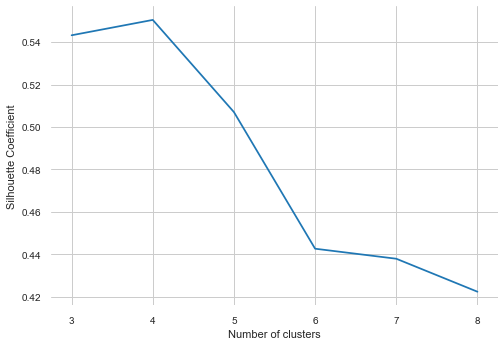

In [133]:
# plot the results
plt.plot(k_range, scores)
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette Coefficient')
plt.grid(True)

The solution can be 4 based on the SC score. If we take highest SC score, 4 segment solution is best

#### Choosing number clusters using Pseudo F-value (elbow method)

In [134]:
cluster_range = range( 3, 9 )
cluster_errors = []

for num_clusters in cluster_range:
    clusters = KMeans( num_clusters )
    clusters.fit( data_scaled2 )
    cluster_errors.append( clusters.inertia_ )

In [135]:
clusters_df = pd.DataFrame( { "num_clusters":cluster_range, "cluster_errors": cluster_errors } )

clusters_df[0:6]

,num_clusters,cluster_errors
0,3,19783.995128
1,4,16561.817610
2,5,13834.323807
3,6,12266.505572
4,7,11339.054818
5,8,10562.004381


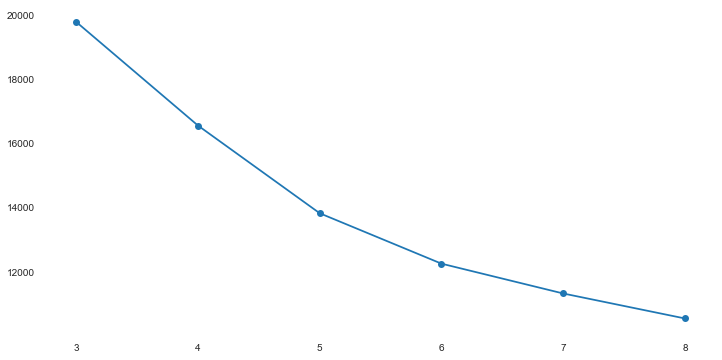

In [136]:
# allow plots to appear in the notebook
plt.figure(figsize=(12,6))
plt.plot( clusters_df.num_clusters, clusters_df.cluster_errors, marker = "o" )

The elbow diagram shows that the gain in explained variance reduces significantly from 3 to 4. So, optimal number of clusters could be 4.

#### Profiling

In [138]:
df_num.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,...,TENURE,Monthly_avg_purchase,Monthly_cash_advance,limit_usage,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,cluster_8
0,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,...,12,7.950000,0.000000,0.040901,0,0,0,1,0,0
1,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,...,12,0.000000,536.912124,0.457495,0,0,0,1,0,0
2,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,...,12,64.430833,0.000000,0.332687,2,1,4,0,1,3
3,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,...,12,124.916667,17.149001,0.222223,0,0,0,5,5,5
4,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,...,12,1.333333,0.000000,0.681429,0,0,0,1,0,0


In [140]:
# Percentage of values in cluster_3
df_num.cluster_3.value_counts()*100/sum(df_num.cluster_3.value_counts())

0    75.553073
2    19.955307
1     4.491620
Name: cluster_3, dtype: float64

In [141]:
# number of values in cluster_4
pd.Series.sort_index(df_num.cluster_4.value_counts())

0    6434
1    1717
2     397
3     402
Name: cluster_4, dtype: int64

In [143]:
# number of values in each cluster 
size=pd.concat([pd.Series(df_num.cluster_3.size), pd.Series.sort_index(df_num.cluster_3.value_counts()), pd.Series.sort_index(df_num.cluster_4.value_counts()),
           pd.Series.sort_index(df_num.cluster_5.value_counts()), pd.Series.sort_index(df_num.cluster_6.value_counts()),
           pd.Series.sort_index(df_num.cluster_7.value_counts()), pd.Series.sort_index(df_num.cluster_8.value_counts())])

In [144]:
size

0    8950
0    6762
1     402
2    1786
0    6434
1    1717
2     397
3     402
0    6032
1     640
2     226
3     396
4    1656
0     871
1    5375
2     210
3     369
4     575
5    1550
0    5327
1     841
2     203
3     370
4     272
5    1569
6     368
0    5108
1     490
2     250
3     736
4     124
5    1628
6     362
7     252
dtype: int64

In [145]:
Seg_size=pd.DataFrame(size, columns=['Seg_size'])
Seg_Pct = pd.DataFrame(size/df_num.cluster_3.size, columns=['Seg_Pct'])
Seg_size.T

,0,0,1,2,0,1,2,3,0,1,...,5,6,0,1,2,3,4,5,6,7
Seg_size,8950,6762,402,1786,6434,1717,397,402,6032,640,...,1569,368,5108,490,250,736,124,1628,362,252


In [146]:
Seg_Pct.T

,0,0,1,2,0,1,2,3,0,1,...,5,6,0,1,2,3,4,5,6,7
Seg_Pct,1.0,0.755531,0.044916,0.199553,0.718883,0.191844,0.044358,0.044916,0.673966,0.071508,...,0.175307,0.041117,0.570726,0.054749,0.027933,0.082235,0.013855,0.181899,0.040447,0.028156


In [147]:
pd.concat([Seg_size.T, Seg_Pct.T], axis=0)

,0,0,1,2,0,1,2,3,0,1,...,5,6,0,1,2,3,4,5,6,7
Seg_size,8950.0,6762.000000,402.000000,1786.000000,6434.000000,1717.000000,397.000000,402.000000,6032.000000,640.000000,...,1569.000000,368.000000,5108.000000,490.000000,250.000000,736.000000,124.000000,1628.000000,362.000000,252.000000
Seg_Pct,1.0,0.755531,0.044916,0.199553,0.718883,0.191844,0.044358,0.044916,0.673966,0.071508,...,0.175307,0.041117,0.570726,0.054749,0.027933,0.082235,0.013855,0.181899,0.040447,0.028156


In [148]:
# Mean value gives a good indication of the distribution of df. So we are finding mean value for each variable for each cluster
Profling_output = pd.concat([df_num.apply(lambda x: x.mean()).T, df_num.groupby('cluster_3').apply(lambda x: x.mean()).T, df_num.groupby('cluster_4').apply(lambda x: x.mean()).T,
          df_num.groupby('cluster_5').apply(lambda x: x.mean()).T, df_num.groupby('cluster_6').apply(lambda x: x.mean()).T,
          df_num.groupby('cluster_7').apply(lambda x: x.mean()).T, df_num.groupby('cluster_8').apply(lambda x: x.mean()).T], axis=1)

In [149]:
Profling_output

,0,0,1,2,0,1,2,3,0,1,...,5,6,0,1,2,3,4,5,6,7
BALANCE,1541.046707,1405.077872,3119.289808,1700.602996,1319.622263,1632.998653,3122.430886,3130.484175,1318.392623,2242.452843,...,1458.730083,3181.878275,1323.151030,1789.165212,2201.961276,1321.423710,3472.693050,1400.799089,3206.087014,3024.782084
BALANCE_FREQUENCY,0.878083,0.850726,0.977682,0.959242,0.851469,0.963559,0.978546,0.839751,0.847982,0.973373,...,0.919080,0.838423,0.838185,0.951390,0.988039,0.967170,0.985264,0.908582,0.838206,0.982517
PURCHASES,936.229237,338.049475,6420.592164,1966.563869,342.118177,1977.407630,6452.840655,549.941990,296.237866,3619.181844,...,1295.149796,459.054185,177.018158,3110.120959,2490.462720,1141.116033,8512.978306,1147.730977,441.932845,5573.458492
ONEOFF_PURCHASES,536.493774,119.891724,4310.735791,1264.275280,120.067850,1281.732429,4333.505713,268.573085,87.695489,2351.162813,...,560.981466,222.023098,48.772191,2310.666531,831.936400,913.896359,6135.391750,499.252310,213.702155,3526.670599
INSTALLMENTS_PURCHASES,384.498368,218.459086,1780.193350,698.993465,222.358208,692.381915,1785.519991,280.936570,208.823538,1229.911252,...,733.872538,236.560871,128.550347,789.580233,1631.873216,227.219674,1966.580556,648.442096,227.752681,1748.264825
CASH_ADVANCE,935.920972,1008.740315,879.629011,672.889042,826.676458,545.389326,829.753816,4457.240379,846.980610,673.775203,...,611.183007,4627.647032,882.322394,567.967507,718.446860,488.934172,818.339469,643.248586,4693.590631,809.745909
PURCHASES_FREQUENCY,0.490351,0.371348,0.926292,0.842786,0.380709,0.850251,0.928512,0.275268,0.364430,0.916179,...,0.708786,0.251033,0.306463,0.836957,0.977162,0.850817,0.933211,0.676522,0.244558,0.940474
ONEOFF_PURCHASES_FREQUENCY,0.202458,0.064782,0.751444,0.600144,0.065462,0.612436,0.754611,0.098707,0.049346,0.684769,...,0.204253,0.089121,0.036577,0.633991,0.442672,0.776184,0.836695,0.189871,0.086869,0.747072
PURCHASES_INSTALLMENTS_FREQUENCY,0.364437,0.304148,0.721646,0.512297,0.312707,0.514206,0.723598,0.197999,0.307580,0.694721,...,0.575733,0.180781,0.257551,0.540549,0.937668,0.305815,0.688217,0.541401,0.174109,0.761955
CASH_ADVANCE_FREQUENCY,0.134017,0.145857,0.091267,0.098810,0.136297,0.091037,0.087169,0.327356,0.138740,0.089988,...,0.095410,0.336871,0.146323,0.080572,0.107900,0.092036,0.081317,0.099065,0.341763,0.090308


In [150]:
Profling_output_final=pd.concat([ Profling_output,Seg_size.T, Seg_Pct.T], axis=0)

In [152]:
Profling_output_final.head()

,0,0,1,2,0,1,2,3,0,1,...,5,6,0,1,2,3,4,5,6,7
BALANCE,1541.046707,1405.077872,3119.289808,1700.602996,1319.622263,1632.998653,3122.430886,3130.484175,1318.392623,2242.452843,...,1458.730083,3181.878275,1323.151030,1789.165212,2201.961276,1321.423710,3472.693050,1400.799089,3206.087014,3024.782084
BALANCE_FREQUENCY,0.878083,0.850726,0.977682,0.959242,0.851469,0.963559,0.978546,0.839751,0.847982,0.973373,...,0.919080,0.838423,0.838185,0.951390,0.988039,0.967170,0.985264,0.908582,0.838206,0.982517
PURCHASES,936.229237,338.049475,6420.592164,1966.563869,342.118177,1977.407630,6452.840655,549.941990,296.237866,3619.181844,...,1295.149796,459.054185,177.018158,3110.120959,2490.462720,1141.116033,8512.978306,1147.730977,441.932845,5573.458492
ONEOFF_PURCHASES,536.493774,119.891724,4310.735791,1264.275280,120.067850,1281.732429,4333.505713,268.573085,87.695489,2351.162813,...,560.981466,222.023098,48.772191,2310.666531,831.936400,913.896359,6135.391750,499.252310,213.702155,3526.670599
INSTALLMENTS_PURCHASES,384.498368,218.459086,1780.193350,698.993465,222.358208,692.381915,1785.519991,280.936570,208.823538,1229.911252,...,733.872538,236.560871,128.550347,789.580233,1631.873216,227.219674,1966.580556,648.442096,227.752681,1748.264825


In [153]:
#Profling_output_final.columns = ['Seg_' + str(i) for i in Profling_output_final.columns]
Profling_output_final.columns = ['Overall', 'KM3_1', 'KM3_2', 'KM3_3',
                                'KM4_1', 'KM4_2', 'KM4_3', 'KM4_4',
                                'KM5_1', 'KM5_2', 'KM5_3', 'KM5_4', 'KM5_5',
                                'KM6_1', 'KM6_2', 'KM6_3', 'KM6_4', 'KM6_5','KM6_6',
                                'KM7_1', 'KM7_2', 'KM7_3', 'KM7_4', 'KM7_5','KM7_6','KM7_7',
                                'KM8_1', 'KM8_2', 'KM8_3', 'KM8_4', 'KM8_5','KM8_6','KM8_7','KM8_8',]

In [154]:
Profling_output_final.head()

,Overall,KM3_1,KM3_2,KM3_3,KM4_1,KM4_2,KM4_3,KM4_4,KM5_1,KM5_2,...,KM7_6,KM7_7,KM8_1,KM8_2,KM8_3,KM8_4,KM8_5,KM8_6,KM8_7,KM8_8
BALANCE,1541.046707,1405.077872,3119.289808,1700.602996,1319.622263,1632.998653,3122.430886,3130.484175,1318.392623,2242.452843,...,1458.730083,3181.878275,1323.151030,1789.165212,2201.961276,1321.423710,3472.693050,1400.799089,3206.087014,3024.782084
BALANCE_FREQUENCY,0.878083,0.850726,0.977682,0.959242,0.851469,0.963559,0.978546,0.839751,0.847982,0.973373,...,0.919080,0.838423,0.838185,0.951390,0.988039,0.967170,0.985264,0.908582,0.838206,0.982517
PURCHASES,936.229237,338.049475,6420.592164,1966.563869,342.118177,1977.407630,6452.840655,549.941990,296.237866,3619.181844,...,1295.149796,459.054185,177.018158,3110.120959,2490.462720,1141.116033,8512.978306,1147.730977,441.932845,5573.458492
ONEOFF_PURCHASES,536.493774,119.891724,4310.735791,1264.275280,120.067850,1281.732429,4333.505713,268.573085,87.695489,2351.162813,...,560.981466,222.023098,48.772191,2310.666531,831.936400,913.896359,6135.391750,499.252310,213.702155,3526.670599
INSTALLMENTS_PURCHASES,384.498368,218.459086,1780.193350,698.993465,222.358208,692.381915,1785.519991,280.936570,208.823538,1229.911252,...,733.872538,236.560871,128.550347,789.580233,1631.873216,227.219674,1966.580556,648.442096,227.752681,1748.264825


In [155]:
Profling_output_final.to_csv('Profiling_output.csv')